## Notebook for Joanito-2022 data processing 
### Developed by: Anna Maguza

### Institute of Computational Biology - Computational Health Centre - Hemlholtz Munich

### 18 October 2022

#### Load packages

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as an
import scrublet
import h5py

#### Setup Cells

In [2]:
%matplotlib inline

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.6 scipy==1.8.1 pandas==1.4.2 scikit-learn==1.1.1 statsmodels==0.13.2 python-igraph==0.9.11 louvain==0.7.1 pynndescent==0.5.7


#### Upload Data

In [ ]:
#Data Upload (csv)
Epithelial_meta = pd.read_csv('/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/Joanito-Epithelial_metadata.csv', index_col=[1])
Nonepithelial_meta = pd.read_csv('/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/Joanito-Nonepithelial_metadata.csv', index_col=[1])

In [ ]:
#Data Upload (csv)
Patientmeta = pd.read_csv('/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/Joanito-patient_clinical_information.csv', index_col=[1], encoding='cp1252')

In [6]:
def read_v3_10x_h5_mod(filename, *, start=None):
    """
    Read hdf5 file from Cell Ranger v3 or later versions.
    """
    with h5py.File(str(filename), 'r') as f:
        try:
            dsets = {}
            sc.readwrite._collect_datasets(dsets, f["matrix"])
            from scipy.sparse import csr_matrix

            M, N = dsets['shape']
            data = dsets['data']
            if dsets['data'].dtype == np.dtype('int32'):
                data = dsets['data'].view('float32')
                data[:] = dsets['data']
            matrix = csr_matrix(
                (data, dsets['indices'], dsets['indptr']),
                shape=(N, M),
            )
            adata = an.AnnData(
                matrix,
                obs=dict(obs_names=dsets['barcodes'].astype(str)),
                var=dict(
                    var_names=dsets['name'].astype(str),
                    feature_types=dsets['feature_type'].astype(str),
                    genome=dsets['genome'].astype(str),
                ),
            )
            return adata
        except KeyError:
            raise Exception('File is missing one or more required datasets.')

In [7]:
Epithelian_data = read_v3_10x_h5_mod('/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/Joanito-Epithelial_Count_matrix.h5')

/var/folders/qc/2mwywtjd73z8jw_s09vv_kzm0000gn/T/ipykernel_49579/1635666716.py:20: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = an.AnnData(


In [8]:
Nonepithelian_data = read_v3_10x_h5_mod('/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/Joanito-Nonepithelial_Count_matrix.h5')

/var/folders/qc/2mwywtjd73z8jw_s09vv_kzm0000gn/T/ipykernel_49579/1635666716.py:20: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = an.AnnData(


#### Preparing anndata file (obs)

In [9]:
#Rename Nonepithelial_meta
Nonepithelial_meta = Nonepithelial_meta.rename(columns={"nCount_RNA": "cell.ID", "msi": "MSS/MSI"})


In [10]:
Nonepithelial_meta

,cell.ID,nFeature_RNA,percent.mt,sample.ID,patient.ID,sample.origin,dataset,cell.type
29514,CRC16_MUX8563_AAACCTGCAAGCCGCT-1,2577,1.235932,MUX8563,CRC2794,Tumor,CRC-SG1,PlasmaB
3259,CRC16_MUX8563_AAACCTGTCTCGATGA-1,1531,6.171890,MUX8563,CRC2794,Tumor,CRC-SG1,T_NK
71212,CRC16_MUX8563_AAACCTGTCTCTGTCG-1,3083,0.891850,MUX8563,CRC2794,Tumor,CRC-SG1,PlasmaB
3771,CRC16_MUX8563_AAACGGGCAAGTTAAG-1,1686,3.639915,MUX8563,CRC2794,Tumor,CRC-SG1,T_NK
16948,CRC16_MUX8563_AAACGGGCAGTTCATG-1,4304,3.975425,MUX8563,CRC2794,Tumor,CRC-SG1,Fibroblast
...,...,...,...,...,...,...,...,...
10870,KUL5_EXT129_TTTGTCAGTTGGACCC-1,1230,1.356960,EXT129,SC044,Normal,KUL5,PlasmaB
1615,KUL5_EXT129_TTTGTCATCAGCATGT-1,983,9.032534,EXT129,SC044,Normal,KUL5,T_NK
1279,KUL5_EXT129_TTTGTCATCCATGAGT-1,850,7.793522,EXT129,SC044,Normal,KUL5,T_NK
25255,KUL5_EXT129_TTTGTCATCGGTTCGG-1,1595,1.074276,EXT129,SC044,Normal,KUL5,PlasmaB


In [11]:
#Merging cells and patients
merged_data_final = pd.concat([Epithelial_meta, Nonepithelial_meta])
merged_data_final = pd.merge(merged_data_final, Patientmeta, 
                   on='patient.ID', how='left')

In [12]:
print(merged_data_final.loc[49150:49160, ])

                                cell.ID  nFeature_RNA  percent.mt sample.ID  \
49150    KUL5_EXT129_CTGTGCTTCGCTTGTC-1          2926   15.401077    EXT129   
49151    KUL5_EXT129_GAAATGAGTTCCTCCA-1          5779   13.561872    EXT129   
49152    KUL5_EXT129_GATCGCGTCTGCTGTC-1          3934   19.530070    EXT129   
49153    KUL5_EXT129_GGAACTTCAGGAATGC-1          5551   11.547377    EXT129   
49154    KUL5_EXT129_TCACAAGGTTTGGGCC-1          3276    9.897333    EXT129   
49155  CRC16_MUX8563_AAACCTGCAAGCCGCT-1          2577    1.235932   MUX8563   
49156  CRC16_MUX8563_AAACCTGTCTCGATGA-1          1531    6.171890   MUX8563   
49157  CRC16_MUX8563_AAACCTGTCTCTGTCG-1          3083    0.891850   MUX8563   
49158  CRC16_MUX8563_AAACGGGCAAGTTAAG-1          1686    3.639915   MUX8563   
49159  CRC16_MUX8563_AAACGGGCAGTTCATG-1          4304    3.975425   MUX8563   
49160  CRC16_MUX8563_AAAGATGAGTTAACGA-1          3080    6.754530   MUX8563   

      patient.ID sample.origin dataset_x   cell.typ

#### Preparing anndata file (var and X)

In [13]:
#Concatenate 2 anndata files (nonepithelial and epithelian)
Joanito_2022 = Nonepithelian_data.concatenate(Epithelian_data)

/Users/annamaguza/miniforge3/envs/cell_analysis/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


#### Final Part in preparing anndata file: Merging obs (clinical and cell data) with X and var (gene counts and genes)

In [14]:
#Create anndata file 
Joanito_2022_anndata = an.AnnData(X=Joanito_2022.X,
                        obs=merged_data_final,
                        var=Joanito_2022.var)

/Users/annamaguza/miniforge3/envs/cell_analysis/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [15]:
#Chacking final anndata
Joanito_2022_anndata.X

<373058x33287 sparse matrix of type '<class 'numpy.float32'>'
	with 741331835 stored elements in Compressed Sparse Row format>

In [16]:
#Chacking final anndata
Joanito_2022_anndata.var

,feature_types,genome
MIR1302-2HG,Gene Expression,GRCh38_ensembl93
FAM138A,Gene Expression,GRCh38_ensembl93
OR4F5,Gene Expression,GRCh38_ensembl93
AL627309.1,Gene Expression,GRCh38_ensembl93
AL627309.3,Gene Expression,GRCh38_ensembl93
...,...,...
AC233755.2,Gene Expression,GRCh38_ensembl93
AC233755.1,Gene Expression,GRCh38_ensembl93
AC240274.1,Gene Expression,GRCh38_ensembl93
AC213203.1,Gene Expression,GRCh38_ensembl93


In [17]:
#Chacking final anndata
Joanito_2022_anndata.obs

,cell.ID,nFeature_RNA,percent.mt,sample.ID,patient.ID,sample.origin,dataset_x,cell.type,iCMS,msi,...,iCMS.transcriptomic,iCMS.inferCNV,KRAS,BRAF,TP53,APC,PIK3CA,LymphNode,Normal,Tumor
0,CRC16_MUX8563_AAACGGGGTCGATTGT-1,5099,17.969349,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,iCMS2,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
1,CRC16_MUX8563_AAAGATGCAGAAGCAC-1,4759,23.734351,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,iCMS2,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
2,CRC16_MUX8563_AAAGCAATCTAACGGT-1,2580,24.403016,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,Normal,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
3,CRC16_MUX8563_ACAGCCGGTCTCTTAT-1,2499,11.020450,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,iCMS2,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
4,CRC16_MUX8563_ACAGCTATCCGTCATC-1,4937,23.243570,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,iCMS2,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
373053,KUL5_EXT129_TTTGTCAGTTGGACCC-1,1230,1.356960,EXT129,SC044,Normal,KUL5,PlasmaB,NaN,NaN,...,iCMS3,iCMS3,wt,wt,wt,wt,NaN,0.0,2.0,3.0
373054,KUL5_EXT129_TTTGTCATCAGCATGT-1,983,9.032534,EXT129,SC044,Normal,KUL5,T_NK,NaN,NaN,...,iCMS3,iCMS3,wt,wt,wt,wt,NaN,0.0,2.0,3.0
373055,KUL5_EXT129_TTTGTCATCCATGAGT-1,850,7.793522,EXT129,SC044,Normal,KUL5,T_NK,NaN,NaN,...,iCMS3,iCMS3,wt,wt,wt,wt,NaN,0.0,2.0,3.0
373056,KUL5_EXT129_TTTGTCATCGGTTCGG-1,1595,1.074276,EXT129,SC044,Normal,KUL5,PlasmaB,NaN,NaN,...,iCMS3,iCMS3,wt,wt,wt,wt,NaN,0.0,2.0,3.0


In [18]:
#Saving the final anndata file
Joanito_2022_anndata.write('/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/joanito_2022_anndata_raw.h5ad', compression='gzip')

#### Data Quality Check and Preprocessing

In [4]:
#Loading again to further processing
input_CRC_file = '/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/joanito_2022_anndata_raw.h5ad'  # the file that will store the analysis results
output_CRC_file = '/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/joanito_2022_anndata_processed.h5ad'  # the file that will store the analysis results

In [5]:
#Anndata upload
Joanito_ad = sc.read_h5ad(input_CRC_file)
Joanito_ad.X

<373058x33287 sparse matrix of type '<class 'numpy.float32'>'
	with 741331835 stored elements in Compressed Sparse Row format>

In [6]:
Joanito_ad.obs

,cell.ID,nFeature_RNA,percent.mt,sample.ID,patient.ID,sample.origin,dataset_x,cell.type,iCMS,msi,...,iCMS.transcriptomic,iCMS.inferCNV,KRAS,BRAF,TP53,APC,PIK3CA,LymphNode,Normal,Tumor
0,CRC16_MUX8563_AAACGGGGTCGATTGT-1,5099,17.969349,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,iCMS2,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
1,CRC16_MUX8563_AAAGATGCAGAAGCAC-1,4759,23.734351,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,iCMS2,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
2,CRC16_MUX8563_AAAGCAATCTAACGGT-1,2580,24.403016,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,Normal,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
3,CRC16_MUX8563_ACAGCCGGTCTCTTAT-1,2499,11.020450,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,iCMS2,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
4,CRC16_MUX8563_ACAGCTATCCGTCATC-1,4937,23.243570,MUX8563,CRC2794,Tumor,CRC-SG1,Epithelial,iCMS2,MSS,...,iCMS2,iCMS2,wt,wt,mut,mut,wt,0.0,1.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
373053,KUL5_EXT129_TTTGTCAGTTGGACCC-1,1230,1.356960,EXT129,SC044,Normal,KUL5,PlasmaB,NaN,NaN,...,iCMS3,iCMS3,wt,wt,wt,wt,NaN,0.0,2.0,3.0
373054,KUL5_EXT129_TTTGTCATCAGCATGT-1,983,9.032534,EXT129,SC044,Normal,KUL5,T_NK,NaN,NaN,...,iCMS3,iCMS3,wt,wt,wt,wt,NaN,0.0,2.0,3.0
373055,KUL5_EXT129_TTTGTCATCCATGAGT-1,850,7.793522,EXT129,SC044,Normal,KUL5,T_NK,NaN,NaN,...,iCMS3,iCMS3,wt,wt,wt,wt,NaN,0.0,2.0,3.0
373056,KUL5_EXT129_TTTGTCATCGGTTCGG-1,1595,1.074276,EXT129,SC044,Normal,KUL5,PlasmaB,NaN,NaN,...,iCMS3,iCMS3,wt,wt,wt,wt,NaN,0.0,2.0,3.0


In [6]:
#Filter out normal (non-tumor samles)
Joanito_ad_tumor = Joanito_ad[Joanito_ad.obs['sample.origin'] == "Tumor", :]

/Users/annamaguza/miniforge3/envs/cell_analysis/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:08)


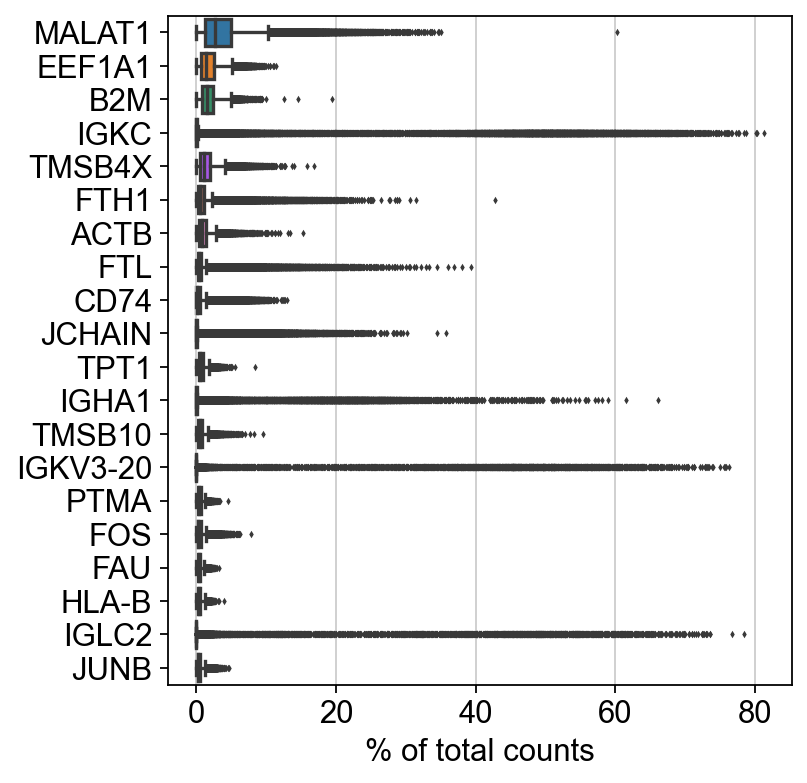

In [8]:
#Show those genes that yield the highest fraction of counts in each single cell, across all cells
sc.pl.highest_expr_genes(Joanito_ad_tumor, n_top=20, )

In [7]:
#Calculate quality control metrics
sc.pp.calculate_qc_metrics(Joanito_ad_tumor, expr_type = 'counts', var_type='genes', percent_top = None, inplace=True)

/Users/annamaguza/miniforge3/envs/cell_analysis/lib/python3.10/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


In [19]:
#Adding percentage of ribosomial genes
Joanito_ad_tumor.var['ribo'] = Joanito_ad_tumor.var_names.str.startswith(("RPS","RPL"))  # annotate the group of ribosomal genes as 'ribo'
sc.pp.calculate_qc_metrics(Joanito_ad_tumor, qc_vars=['ribo'], percent_top=None, log1p=False, inplace=True)

In [31]:
"RPS3" in Joanito_ad_tumor.var_names
#Probably, all rybosomal genes were filtered out by authors

False

In [18]:
#Number of samples
pd.unique(Joanito_ad_tumor.obs['sample.ID'])

['MUX8563', 'MUX8564', 'MUX8568', 'MUX8569', 'MUX8579', ..., 'EXT095', 'EXT097', 'EXT113', 'EXT121', 'EXT127']
Length: 97
Categories (97, object): ['CRC-JSC-S02-GIS-N-US', 'CRC-JSC-S02-GIS-T-US-1', 'CRC-JSC-S02-GIS-T-US-2', 'CRC-JSC-S03-GIS-N-US-1', ..., 'XHC079', 'XHC084', 'XHC087', 'XHC088']

In [9]:
#Total Counts
sum(Joanito_ad_tumor.obs.total_counts)

1201793450.0

In [10]:
#Mean Genes per Cell
sum(Joanito_ad_tumor.obs.n_genes_by_counts)/170596

1785.0331309057656

In [11]:
#Mean Reads per Cell
sum(Joanito_ad_tumor.obs.total_counts)/170596

7044.675432014818

In [13]:
#Mean percentage of mitochondrial counts
from statistics import mean
mean(Joanito_ad_tumor.obs['percent.mt'])

6.4581119913777725

In [11]:
list(Joanito_ad_tumor.obs)

['cell.ID',
 'nFeature_RNA',
 'percent.mt',
 'sample.ID',
 'patient.ID',
 'sample.origin',
 'dataset_x',
 'cell.type',
 'iCMS',
 'msi',
 'dataset_y',
 'Gender',
 'Age at recruitment',
 'MSS/MSI',
 'Site',
 'Sidedness',
 'Group Stage',
 'Stage TNM',
 'iCMS.transcriptomic',
 'iCMS.inferCNV',
 'KRAS',
 'BRAF',
 'TP53',
 'APC',
 'PIK3CA',
 'LymphNode',
 'Normal',
 'Tumor',
 'n_genes_by_counts',
 'log1p_n_genes_by_counts',
 'total_counts',
 'log1p_total_counts']

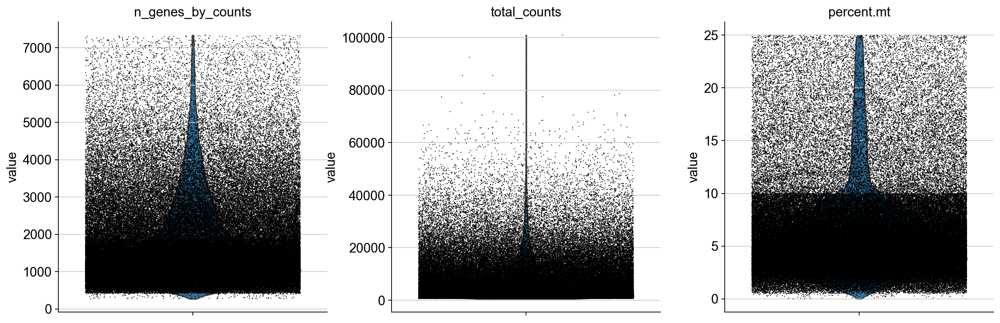

In [27]:
#A violin plot of some of the computed quality measures:
    # the number of genes expressed in the count matrix
    #the total counts per cell
    #the percentage of counts in mitochondrial genes
    #the percentage of counts in ribosomial genes
sc.pl.violin(Joanito_ad_tumor, ['n_genes_by_counts', 'total_counts', 'percent.mt'],
             jitter=0.4, multi_panel=True)

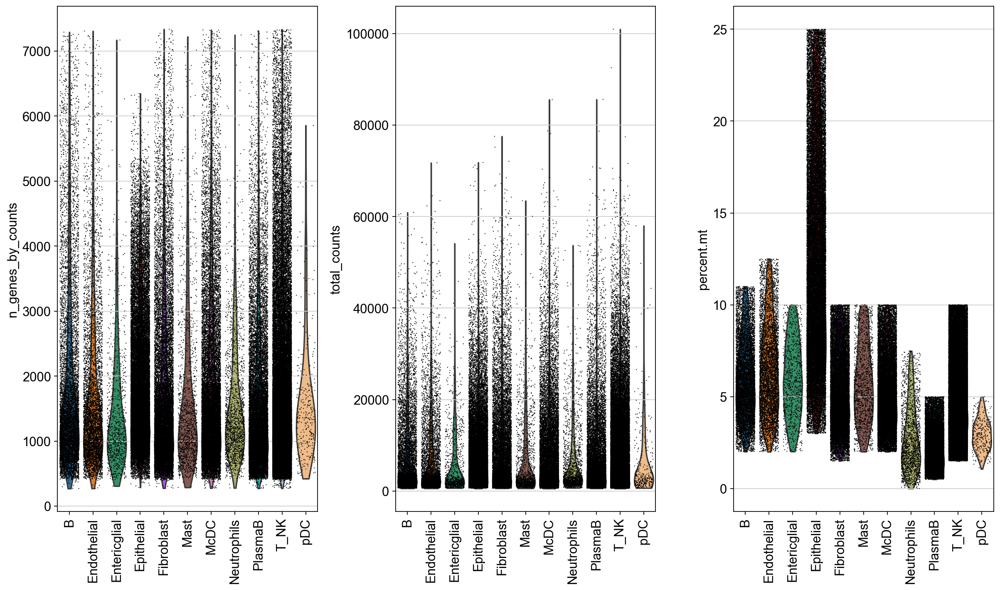

In [32]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(5, 10), dpi=80)
sc.pl.violin(Joanito_ad_tumor, ['n_genes_by_counts', 'total_counts', 'percent.mt'],
             jitter=0.4, groupby = 'cell.type', rotation = 90)

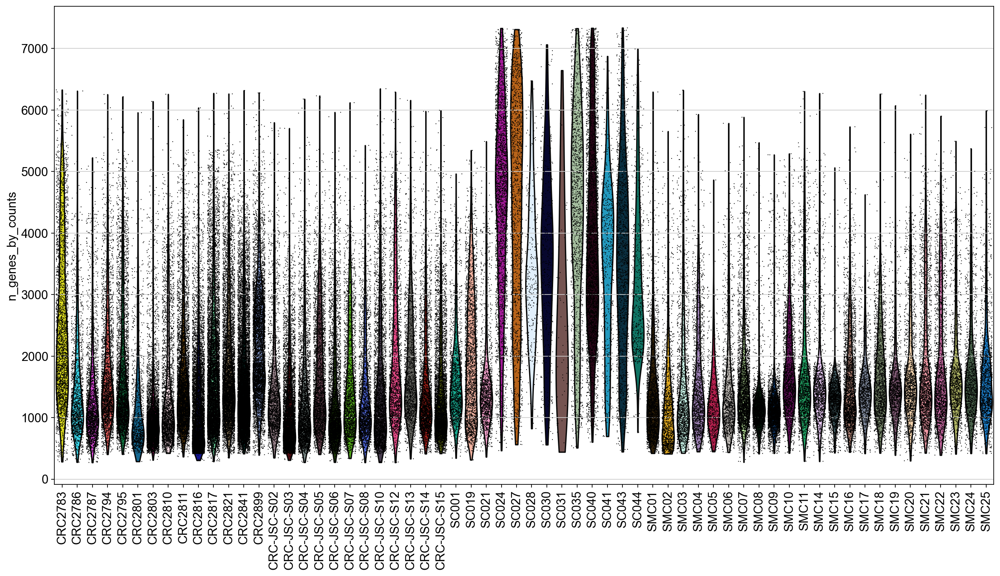

In [35]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(15, 10), dpi=80)
sc.pl.violin(Joanito_ad_tumor, ['n_genes_by_counts'],
             jitter=0.4, groupby = 'patient.ID', rotation = 90)

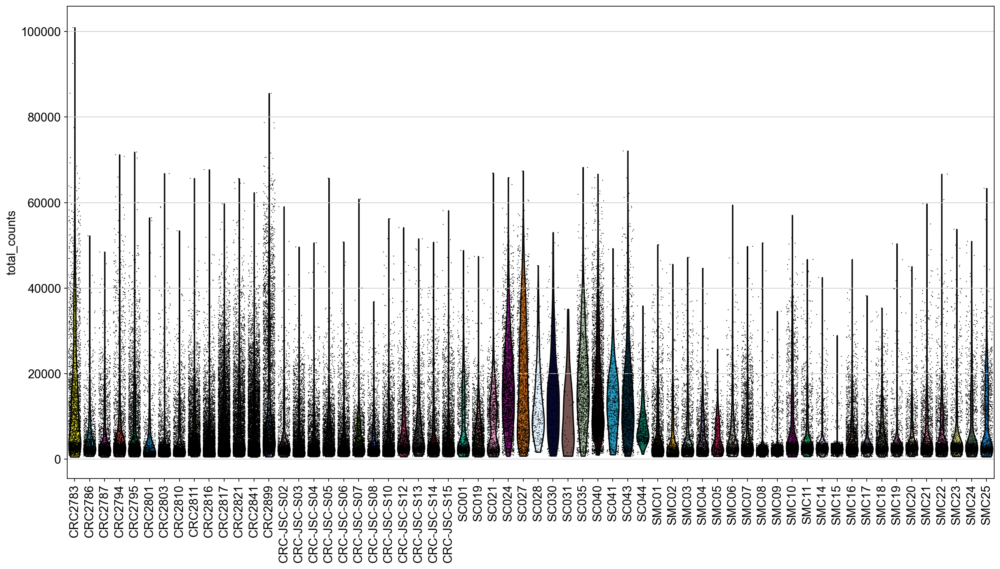

In [36]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(15, 10), dpi=80)
sc.pl.violin(Joanito_ad_tumor, ['total_counts'],
             jitter=0.4, groupby = 'patient.ID', rotation = 90)

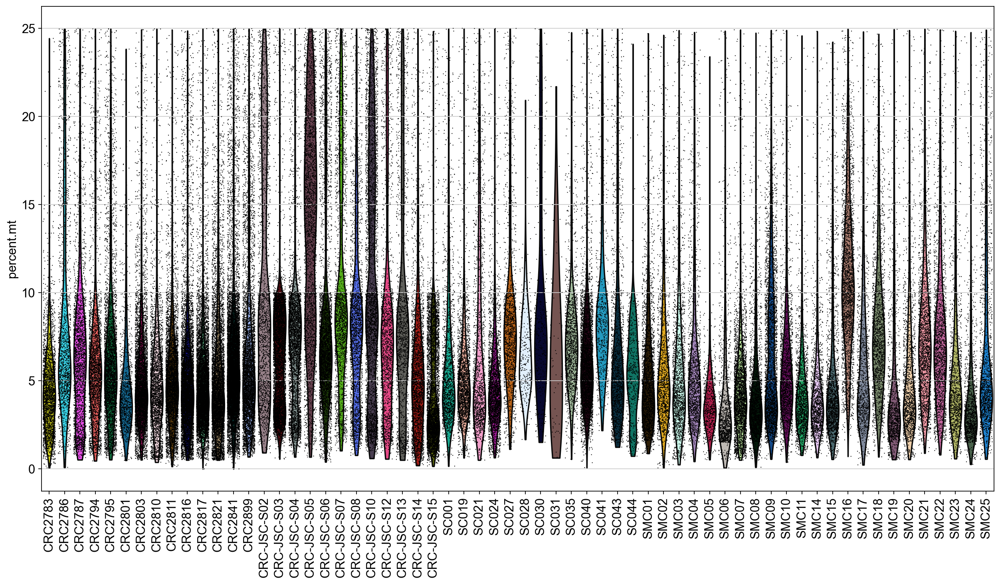

In [38]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(15, 10), dpi=80)
sc.pl.violin(Joanito_ad_tumor, ['percent.mt'],
             jitter=0.4, groupby = 'patient.ID', rotation = 90)

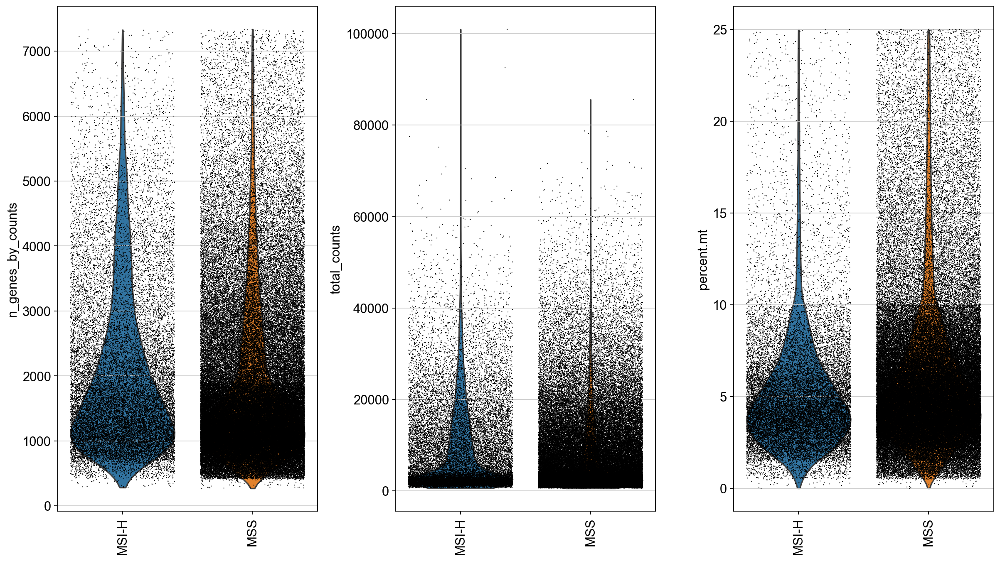

In [39]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(5, 10), dpi=80)
sc.pl.violin(Joanito_ad_tumor, ['n_genes_by_counts', 'total_counts', 'percent.mt'],
             jitter=0.4, groupby = 'MSS/MSI', rotation = 90)

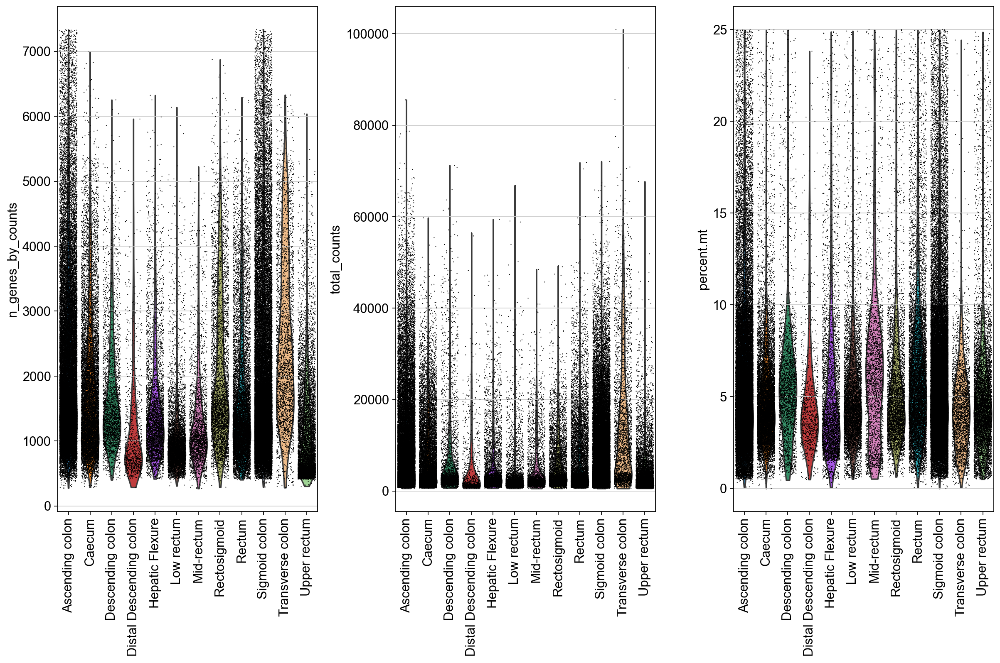

In [40]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(5, 10), dpi=80)
sc.pl.violin(Joanito_ad_tumor, ['n_genes_by_counts', 'total_counts', 'percent.mt'],
             jitter=0.4, groupby = 'Site', rotation = 90)

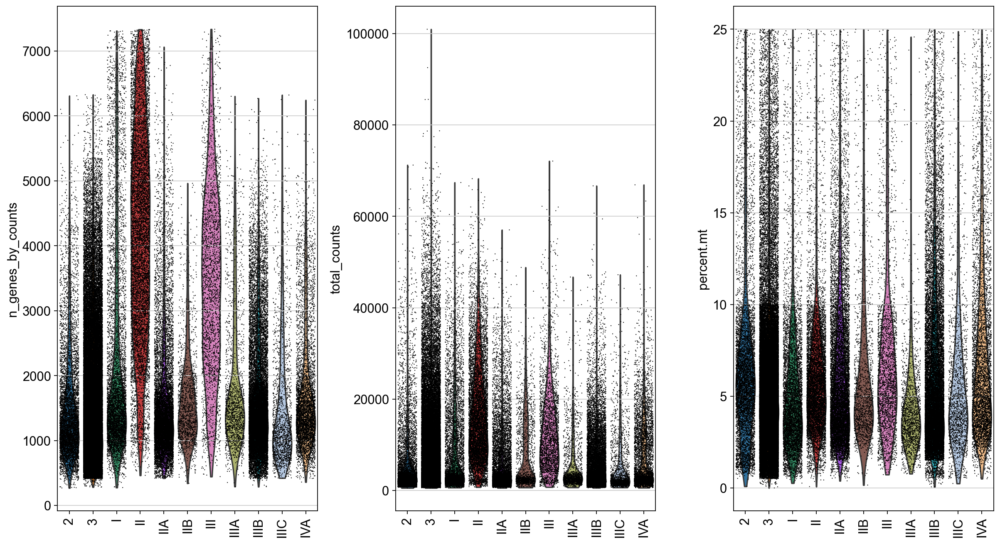

In [41]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(5, 10), dpi=80)
sc.pl.violin(Joanito_ad_tumor, ['n_genes_by_counts', 'total_counts', 'percent.mt'],
             jitter=0.4, groupby = 'Group Stage', rotation = 90)

#### Filtering data

In [33]:
#Filtering by genes
Joanito_ad_tumor_clean = Joanito_ad_tumor[Joanito_ad_tumor.obs.n_genes_by_counts < 4000, :]
Joanito_ad_tumor_clean = Joanito_ad_tumor_clean[Joanito_ad_tumor_clean.obs.n_genes_by_counts > 200, :]

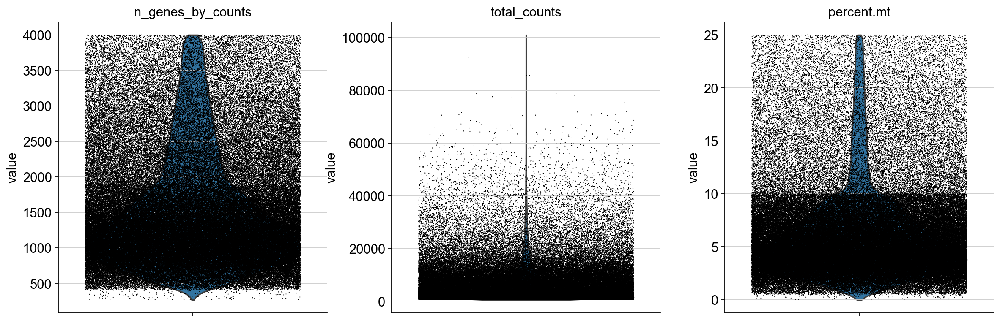

In [10]:
#A violin plot of some of the computed quality measures:
    # the number of genes expressed in the count matrix
    #the total counts per cell
    #the percentage of counts in mitochondrial genes
    #the percentage of counts in ribosomial genes
sc.pl.violin(Joanito_ad_tumor_clean, ['n_genes_by_counts', 'total_counts', 'percent.mt'],
             jitter=0.4, multi_panel=True)

/Users/annamaguza/miniforge3/envs/cell_analysis/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


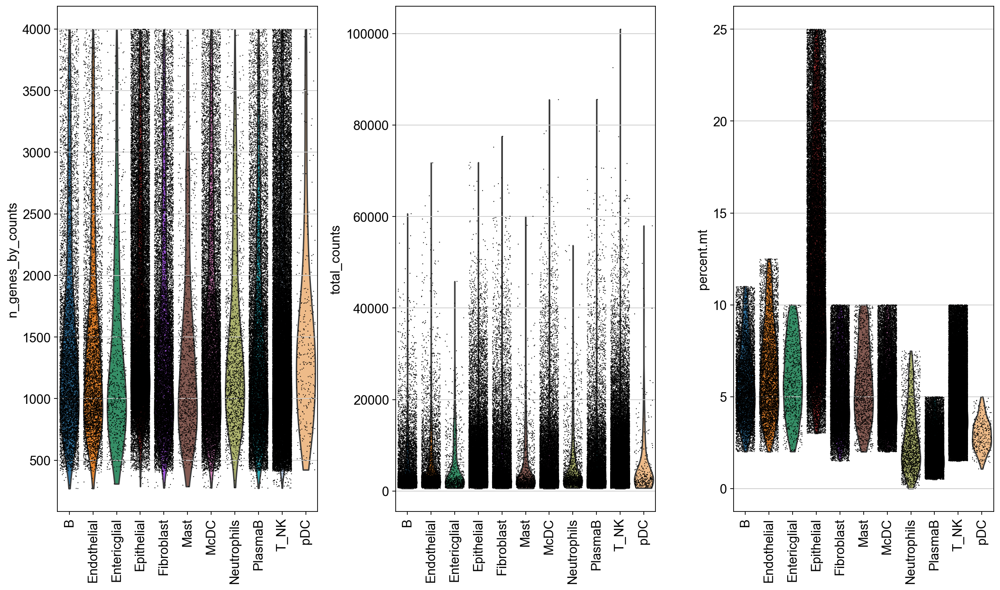

In [11]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(5, 10), dpi=80)
sc.pl.violin(Joanito_ad_tumor_clean, ['n_genes_by_counts', 'total_counts', 'percent.mt'],
             jitter=0.4, groupby = 'cell.type', rotation = 90)

In [9]:
#Filtering by counts
Joanito_ad_tumor_clean = Joanito_ad_tumor_clean[Joanito_ad_tumor_clean.obs.total_counts < 3000, :]


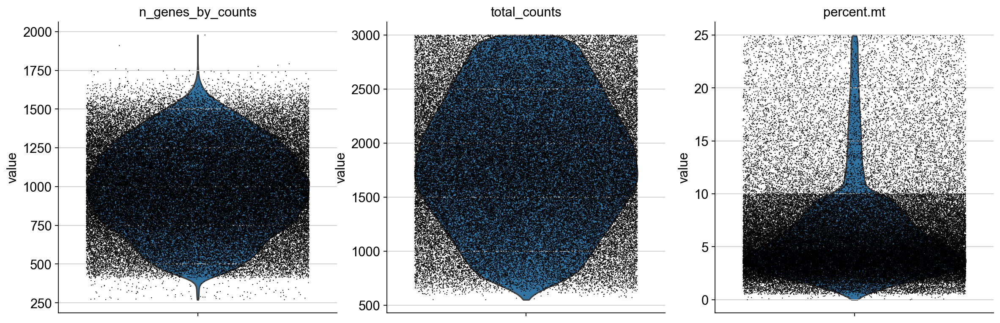

In [13]:
#A violin plot of some of the computed quality measures:
    # the number of genes expressed in the count matrix
    #the total counts per cell
    #the percentage of counts in mitochondrial genes
    #the percentage of counts in ribosomial genes
sc.pl.violin(Joanito_ad_tumor_clean, ['n_genes_by_counts', 'total_counts', 'percent.mt'],
             jitter=0.4, multi_panel=True)

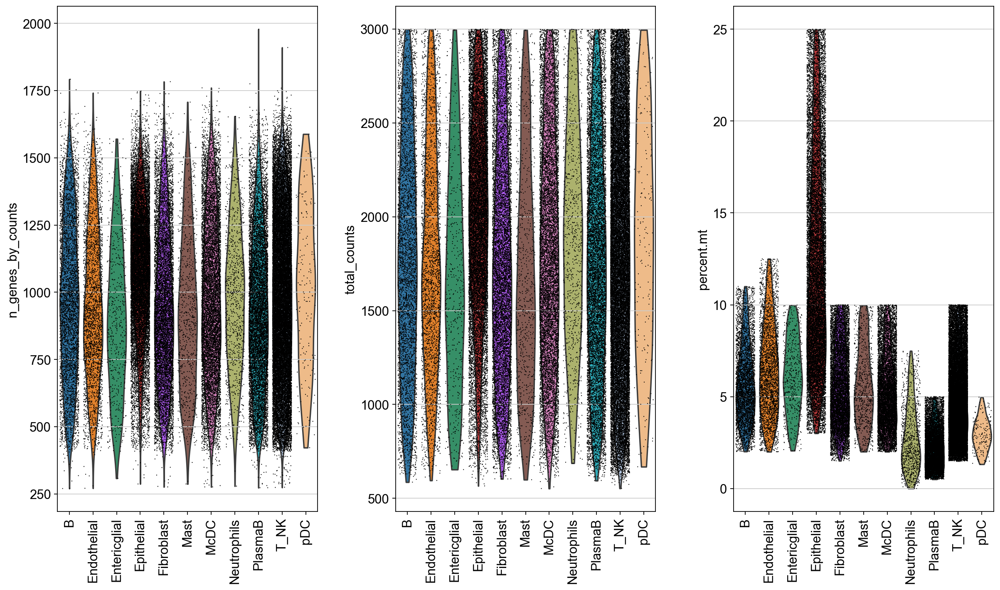

In [14]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(5, 10), dpi=80)
sc.pl.violin(Joanito_ad_tumor_clean, ['n_genes_by_counts', 'total_counts', 'percent.mt'],
             jitter=0.4, groupby = 'cell.type', rotation = 90)

#### UMAP with QC

In [34]:
#Identification of hightly variable genes to run UMAP
sc.pp.highly_variable_genes(Joanito_ad_tumor_clean, flavor = 'seurat_v3', n_top_genes=2000)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/Users/annamaguza/miniforge3/envs/cell_analysis/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [36]:
#Neighbors calculating for UMAP
sc.pp.neighbors(Joanito_ad_tumor_clean, n_neighbors = 50, n_pcs = 50)

computing neighbors
         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:08:19)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:09:10)


In [37]:
#UMAP with QC parameters
sc.tl.umap(Joanito_ad_tumor_clean)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:59)


In [45]:
list(Joanito_ad_tumor.obs)

['cell.ID',
 'nFeature_RNA',
 'percent.mt',
 'sample.ID',
 'patient.ID',
 'sample.origin',
 'dataset_x',
 'cell.type',
 'iCMS',
 'msi',
 'dataset_y',
 'Gender',
 'Age at recruitment',
 'MSS/MSI',
 'Site',
 'Sidedness',
 'Group Stage',
 'Stage TNM',
 'iCMS.transcriptomic',
 'iCMS.inferCNV',
 'KRAS',
 'BRAF',
 'TP53',
 'APC',
 'PIK3CA',
 'LymphNode',
 'Normal',
 'Tumor',
 'n_genes_by_counts',
 'log1p_n_genes_by_counts',
 'total_counts',
 'log1p_total_counts']

In [38]:
%matplotlib 
sc.pl.umap(Joanito_ad_tumor_clean, color_map = "magma", color=['n_genes_by_counts', 'total_counts', 'percent.mt'])

Using matplotlib backend: <object object at 0x12b9ca1b0>


In [40]:
sc.set_figure_params(figsize=(10, 10),dpi=60)
sc.pl.umap(Joanito_ad_tumor_clean, color_map = "magma", color=['n_genes_by_counts', 'total_counts', 'percent.mt'])

In [15]:
#UMAP with QC parameters
%matplotlib 
sc.set_figure_params(figsize=(10, 10),dpi=200)
sc.pl.umap(Joanito_ad_tumor_clean, color_map = "magma", color=['n_genes_by_counts', 'total_counts', 'percent.mt', 'cell.type', 'iCMS', 'Gender', 'Age at recruitment', 'MSS/MSI', 'Site', 'Sidedness', 'Group Stage', 'Stage TNM', 'iCMS.transcriptomic', 'iCMS.inferCNV', 'LymphNode', "patient.ID", "sample.ID"])

Using matplotlib backend: <object object at 0x12fd6cf30>


#### Doublets calculation

In [ ]:
scrub = scrublet.Scrublet(Joanito_ad_tumor.X)

In [ ]:
Joanito_ad_tumor.obs['doublet_scores'], Joanito_ad_tumor.obs['predicted_doublets'] = scrub.scrub_doublets()
scrub.plot_histogram()

In [ ]:
sum(Joanito_ad_tumor.obs['predicted_doublets'])

In [ ]:
# add in column with singlet/doublet instead of True/False
Joanito_ad_tumor.obs['doublet_info'] = Joanito_ad_tumor.obs["predicted_doublets"].astype(str)

In [ ]:
%matplotlib inline
#check if our predicted doublets also have more detected genes in general
sc.pl.violin(Joanito_ad_tumor, 'n_genes_by_counts',
             jitter=0.4, groupby = 'doublet_info', rotation=45)

In [ ]:
#Lets run PCA and UMAP and plot doublet scores onto umap to check the doublet predictions.
sc.pp.highly_variable_genes(Joanito_ad_tumor, flavor = 'seurat_v3', n_top_genes=2000)

In [ ]:
Joanito_ad_tumor_scrublet = Joanito_ad_tumor[:, Joanito_ad_tumor.var.highly_variable]

In [ ]:
sc.pp.regress_out(Joanito_ad_tumor_scrublet, ['total_counts', 'pct_counts_mt'])

In [ ]:
sc.pp.scale(Joanito_ad_tumor_scrublet, max_value=10)

In [ ]:
sc.pp.neighbors(Joanito_ad_tumor_scrublet, n_neighbors = 50, n_pcs = 50)

In [ ]:
sc.tl.umap(Joanito_ad_tumor_scrublet)

In [ ]:
%matplotlib inline
sc.pl.umap(Joanito_ad_tumor_scrublet, color_map = "magma", color=['doublet_scores','doublet_info','samples'])

#### Calculate cell cycle scores

In [ ]:
sc.pl.umap(Joanito_ad_tumor, color_map = "magma", color=['EXO1'])

In [ ]:
Joanito_ad_tumor.var_names

In [ ]:
!if [ ! -f /Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/cell_cycle_genes.txt ]; then curl -o /Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/cell_cycle_genes.txt https://raw.githubusercontent.com/theislab/scanpy_usage/master/180209_cell_cycle/data/regev_lab_cell_cycle_genes.txt; fi

In [ ]:
cell_cycle_genes = [x.strip() for x in open('/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/cell_cycle_genes.txt')]
print(len(cell_cycle_genes))

In [ ]:
# Split into 2 lists
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

In [ ]:
cell_cycle_genes = [x for x in cell_cycle_genes if x in Joanito_ad_tumor.var_names]
print(len(cell_cycle_genes))

In [ ]:
#Create basic anndata for score calculation
adata_log = an.AnnData(X = Joanito_ad_tumor.X,  var = Joanito_ad_tumor.var, obs = Joanito_ad_tumor.obs)
sc.pp.normalize_total(adata_log, target_sum = 1e6, exclude_highly_expressed = True)
sc.pp.log1p(adata_log)

In [ ]:
sc.tl.score_genes_cell_cycle(adata_log, s_genes = s_genes, g2m_genes = g2m_genes)
sc.pl.violin(adata_log, ['S_score', 'G2M_score'],
             jitter = 0.4, groupby = 'samples', rotation = 45)

In [ ]:
Joanito_ad_tumor.obs['S_score'] = adata_log.obs['S_score']
Joanito_ad_tumor.obs['G2M_score'] = adata_log.obs['G2M_score']
Joanito_ad_tumor